<a href="https://colab.research.google.com/github/guilhermelaviola/ApplicationsOfDataScienceInDisruptiveTechnologies/blob/main/Class09.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **MOSSE (Minimum Output Sum of Squared Error)**
O algoritmo MUSE (Minimum Output Sum of Squared Error) é uma técnica eficiente de visão computacional para rastreamento de objetos em vídeos, especialmente em aplicações em tempo real como vigilância. Ele minimiza o erro quadrático entre a saída do rastreador e a imagem do objeto, ajustando um filtro adaptativo à sua aparência ao longo do tempo. Embora seja simples e tenha baixo custo computacional, o MUSE enfrenta dificuldades ao lidar com mudanças drásticas na aparência do objeto. Estratégias como re-inicialização periódica do filtro podem melhorar seu desempenho. Comparado aos algoritmos KCF e CSRT, o MUSE se destaca pela velocidade, sendo ideal quando a eficiência é priorizada, enquanto KCF e CSRT oferecem maior robustez e precisão a um custo computacional maior. Sua implementação em plataformas como Google Colab facilita o uso para estudantes e pesquisadores, tornando-o uma escolha prática para rastreamento eficiente, apesar de algumas limitações em situações complexas.

In [ ]:
# Importing all the necessary libraries and resources:
import cv2
import numpy as np
import matplotlib.pyplot as plt

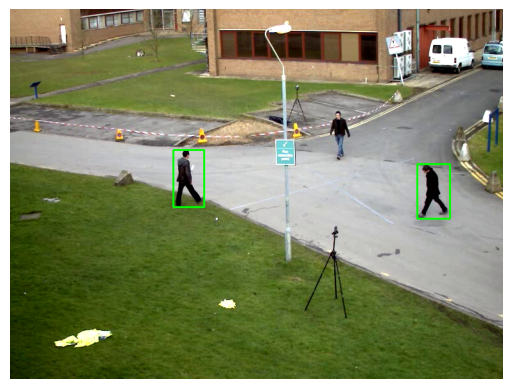

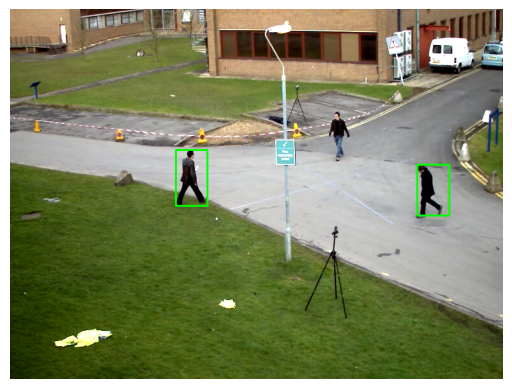

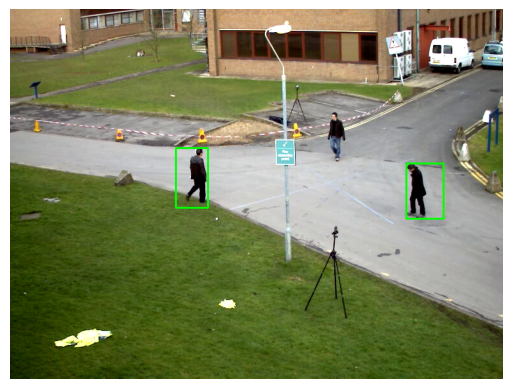

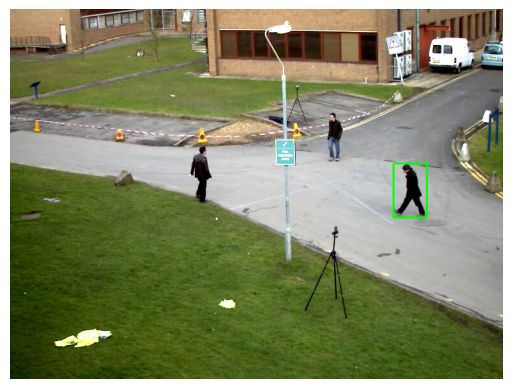

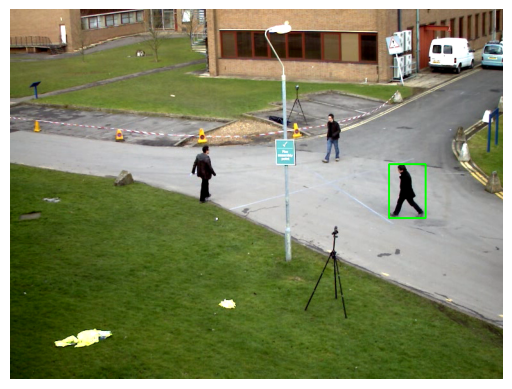

...

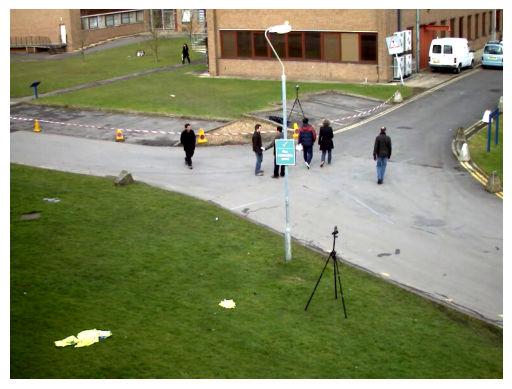

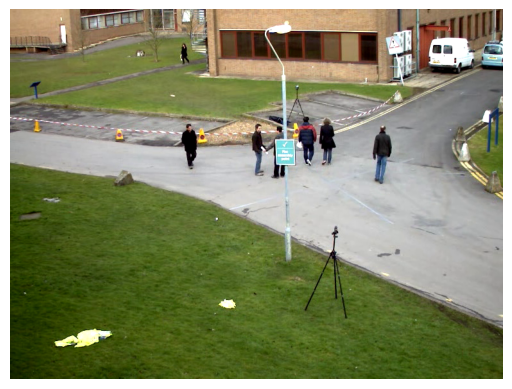

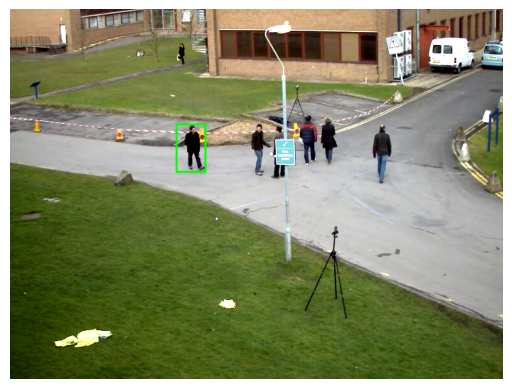

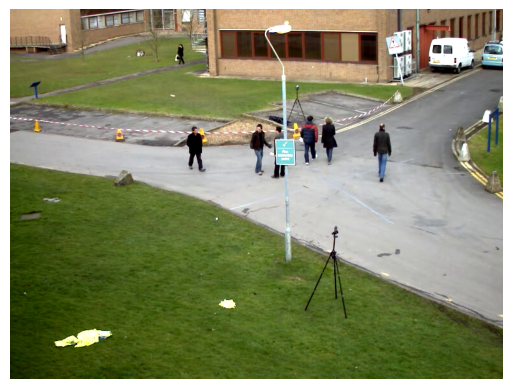

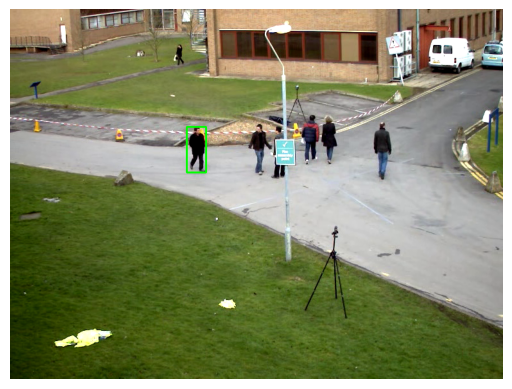

In [ ]:
# Function to process the video
def process_video(video_url):
    # Capturing the video:
    cap = cv2.VideoCapture(video_url)

    # Checking if the video was opened correctly:
    if not cap.isOpened():
        print('Error opening the video.')
        return

    # Initializing the first frame for comparison:
    ret, prev_frame = cap.read()
    prev_frame_gray = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Converting the current frame into grayscale:
        current_frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Calculating the difference between the current frame and the previous one:
        diff_frame = cv2.absdiff(prev_frame_gray, current_frame_gray)

        # Appliying a threshold to detect movement:
        _, thresh_frame = cv2.threshold(diff_frame, 30, 255, cv2.THRESH_BINARY)

        # Finding outlines in the binary image:
        contours, _ = cv2.findContours(thresh_frame, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Drawing the outlines on the original frame:
        for contour in contours:
            if cv2.contourArea(contour) > 500:  # Filtra pequenos contornos
                (x, y, w, h) = cv2.boundingRect(contour)
                cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Displaying the frame with the detections:
        plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        plt.axis('off')  # Oculta os eixos
        plt.show()

        # Updating the previous frame:
        prev_frame_gray = current_frame_gray

        # Pausing for displaying:
        plt.pause(0.1)

    # Releasing the capture
    cap.release()

# OpenCV video URL:
video_url = 'https://github.com/opencv/opencv/blob/master/samples/data/vtest.avi?raw=true'
process_video(video_url)